In [1]:
# Projects details

# objectives : prediction model of meadian house price
# will be fed into another analysis with some# Projects details

# objectives : prediction model of meadian house price
# will be fed into another analysis with some other signals for possible invetsments
# supervised learning - have labled data
# multivariant regression - predict a value based on multiple fetures
# batch learning becase the data is small to fit in memory (if not could be split batch learning or use online # Projects details


In [2]:
# Download the data
import os
import tarfile
from six.moves import urllib

In [3]:
download_root = "https://raw.githubusercontent.com/ageron/handson-ml/master/"
housing_path = os.path.join("datasets", "housing")
housing_url = download_root + "datasets/housing/housing.tgz"
print(download_root)
print(housing_path)
print(housing_url)

https://raw.githubusercontent.com/ageron/handson-ml/master/
datasets/housing
https://raw.githubusercontent.com/ageron/handson-ml/master/datasets/housing/housing.tgz


In [4]:
def fetch_housing_data(housing_url, housing_path):
    if not os.path.isdir(housing_path):
        os.makedirs(housing_path)
    tgz_path = os.path.join(housing_path, "housing.tgz")
    urllib.request.urlretrieve(housing_url, tgz_path)
    housing_tgz = tarfile.open(tgz_path)
    housing_tgz.extractall(path=housing_path)
    housing_tgz.close()

In [5]:
fetch_housing_data(housing_url, housing_path)

In [6]:
# open dataset
import pandas as pd

def load_housing_data(housing_path):
    csv_path = os.path.join(housing_path, "housing.csv")
    return pd.read_csv(csv_path)

In [7]:
housing = load_housing_data(housing_path)

In [8]:
housing.head(10)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY
5,-122.25,37.85,52.0,919.0,213.0,413.0,193.0,4.0368,269700.0,NEAR BAY
6,-122.25,37.84,52.0,2535.0,489.0,1094.0,514.0,3.6591,299200.0,NEAR BAY
7,-122.25,37.84,52.0,3104.0,687.0,1157.0,647.0,3.1200,241400.0,NEAR BAY
8,-122.26,37.84,42.0,2555.0,665.0,1206.0,595.0,2.0804,226700.0,NEAR BAY
9,-122.25,37.84,52.0,3549.0,707.0,1551.0,714.0,3.6912,261100.0,NEAR BAY


In [9]:
housing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
longitude             20640 non-null float64
latitude              20640 non-null float64
housing_median_age    20640 non-null float64
total_rooms           20640 non-null float64
total_bedrooms        20433 non-null float64
population            20640 non-null float64
households            20640 non-null float64
median_income         20640 non-null float64
median_house_value    20640 non-null float64
ocean_proximity       20640 non-null object
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


In [10]:
housing.ocean_proximity.unique()

array(['NEAR BAY', '<1H OCEAN', 'INLAND', 'NEAR OCEAN', 'ISLAND'],
      dtype=object)

In [11]:
housing["ocean_proximity"].value_counts()

<1H OCEAN     9136
INLAND        6551
NEAR OCEAN    2658
NEAR BAY      2290
ISLAND           5
Name: ocean_proximity, dtype: int64

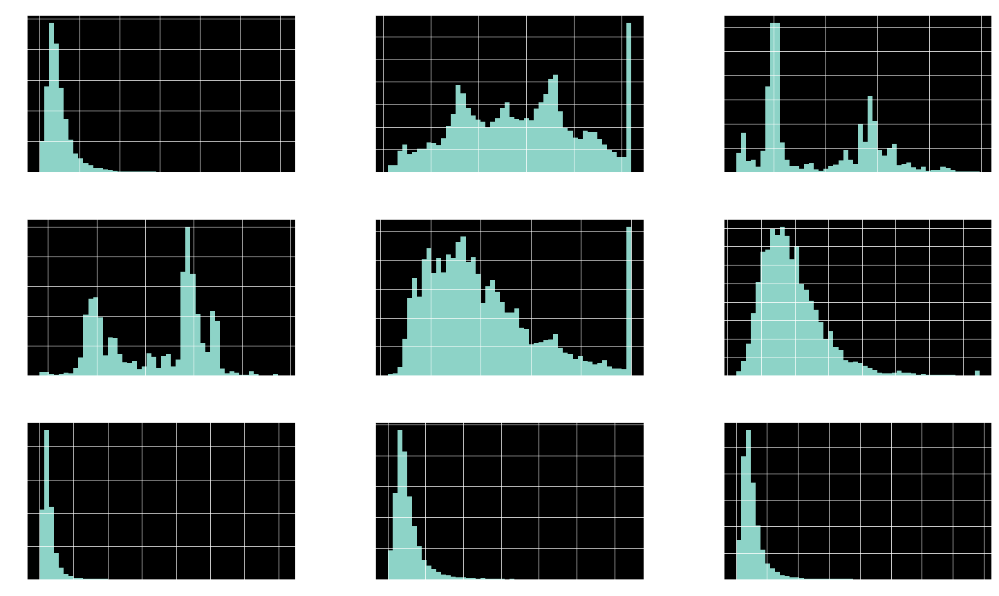

In [12]:
# plot the dataset for numerical column
%matplotlib inline
import matplotlib.pyplot as plt

housing.hist(bins=50, figsize=(25, 15))
plt.show()

In [29]:
#  No peaking separate the test data
import numpy as np

def split_train_test(data, test_ratio):
    shuffled_indices = np.random.permutation(len(data))
    print(shuffled_indices)
    print(len(shuffled_indices), int(len(data)*test_ratio))
    test_set_size = int(len(data)*test_ratio)
    print(shuffled_indices[2:])
    test_indices = shuffled_indices[:test_set_size]
    train_indices = shuffled_indices[test_set_size:]

    return data.iloc[train_indices], data.iloc[test_indices]

In [30]:
train_set, test_set = split_train_test(housing, 0.2)
print(len(train_set),"train +", len(test_set), "test")

[11105 16654 11968 ... 18810  8175  3239]
20640 4128
[11968 10865 16758 ... 18810  8175  3239]
16512 train + 4128 test


In [37]:
housing["median_income"]

0        8.3252
1        8.3014
2        7.2574
3        5.6431
4        3.8462
          ...  
20635    1.5603
20636    2.5568
20637    1.7000
20638    1.8672
20639    2.3886
Name: median_income, Length: 20640, dtype: float64

In [46]:
import seaborn as sns

housing["income_cat"] = np.ceil(housing["median_income"]/1.5)

housing["income_cat"].unique()
housing["income_cat"].where(housing["income_cat"]< 5, 5.0, inplace=True)

housing["income_cat"].unique()

array([5., 4., 3., 2., 1.])

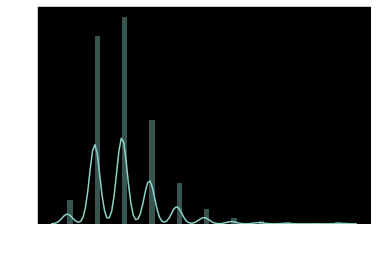

In [44]:
sns.distplot(np.ceil(housing["median_income"]/1.5))     


In [48]:
housing["income_cat"].value_counts()/len(housing)

3.0    0.350581
2.0    0.318847
4.0    0.176308
5.0    0.114438
1.0    0.039826
Name: income_cat, dtype: float64

In [50]:
housing.columns

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'median_house_value', 'ocean_proximity', 'income_cat'],
      dtype='object')

In [52]:
housing.drop("income_cat",axis=1, inplace=True)
housing.columns

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'median_house_value', 'ocean_proximity'],
      dtype='object')

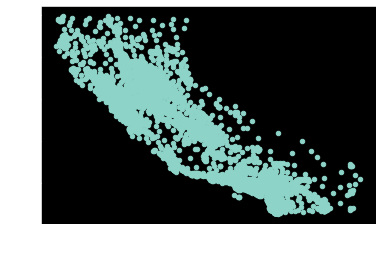

In [58]:
housing.plot(kind="scatter", x="longitude", y="latitude")

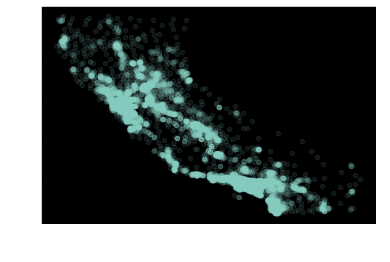

In [57]:
housing.plot(kind="scatter", x="longitude", y="latitude", alpha=0.1)

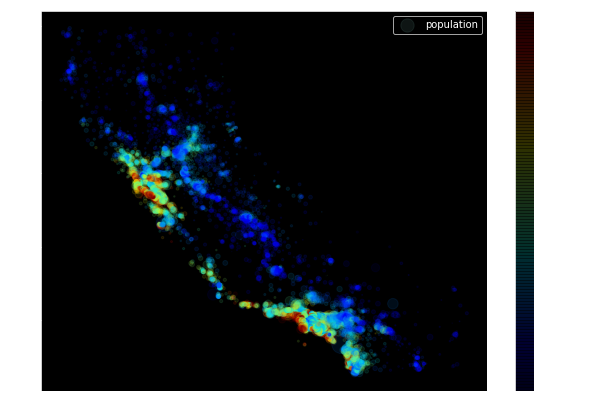

In [63]:
housing.plot(kind="scatter", x="longitude", y="latitude", alpha=0.1, s=housing["population"]/100, label="population", figsize=(10, 7), c = "median_house_value", cmap=plt.get_cmap("jet"), colorbar=True,)